In [1]:
import pandas as pd
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scipy.fft
import glob as gb
import os
import seaborn as sn

from scipy.stats import *

from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt

In [2]:
class Features:
    def __init__(self, fftlist):
        self.fftlist=fftlist
#     def features(self, fftList):#fftlist must be of type pandas
#         self.rolling_mean = fftList.rolling(500).mean()
#         self.rolling_median = fftList.rolling(500).median()
#         self.rolling_std1 = fftList.rolling(500).std()
#         self.rolling_var = fftList.rolling(500).var()
#         self.rolling_skew = fftList.rolling(500).skew()
#         self.rolling_kurt = fftList.rolling(500).kurt()
#         self.rolling_max = fftList.rolling(500).max()
#         self.rolling_min = fftList.rolling(500).min()
#         self.rolling_cov = fftList.rolling(500).cov()#covariance
#         self.rolling_corr = fftList.rolling(500).corr()#correlation
#         self.rolling_sem = fftList.rolling(500).sem()#standard error of mean
#         self.rolling_agg = fftList.rolling(500).aggregate()#aggregation function
#         return self

    def features_normal(self, fftList):#fftlist must be of type pandas
        self.mean = fftList.mean()
        self.median = np.median(fftList)
        self.std1 = fftList.std()
        self.var = fftList.var()
        self.skew =skew(fftList)
        self.kurt = kurtosis(fftList)
        self.max = fftList.max()
        self.min = fftList.min()
        self.rms=np.sqrt(np.mean(fftList**2))
        self.cov = np.cov(fftList)#covariance
        self.crest=np.max(np.abs(fftList))/np.sqrt(np.mean(np.square(fftList)))
        self.form=(np.sqrt(np.mean(fftList**2)))/np.mean(fftList)

        #self.corr = fftList.corr()#correlation
        #self.sem = fftList.sem()#standard error of mean
        #self.agg = fftList.aggregate()#aggregation function
        return self
        
    def Holt_exponential(self,fftlist):
        fit1 = Holt(saledata).fit(smoothing_level=0.8, smoothing_slope=0.2, optimized=False)
        self.fcast1 = fit1.forecast(12).rename("Holt's linear trend")

        fit2 = Holt(saledata, exponential=True).fit(smoothing_level=0.8, smoothing_slope=0.2, optimized=False)
        self.fcast2 = fit2.forecast(12).rename("Exponential trend")

        fit3 = Holt(saledata, damped=True).fit(smoothing_level=0.8, smoothing_slope=0.2)
        self.fcast3 = fit3.forecast(12).rename("Additive damped trend")
        return self
   

In [3]:
#Accordingly enter the path/directory of the file stored in your computer in the quotes below
df1=pd.read_csv(r"D:\MAFAULDA\horizontal-misalignment\0.5mm\12.288.csv",sep=',', header=None)
df1

,0,1,2,3,4,5,6,7
0,-0.49977,0.97159,0.086419,-0.017590,0.64014,0.194930,0.35288,0.021614
1,-0.54833,-1.21600,-0.353530,-0.060630,0.50864,0.195880,0.23587,0.045124
2,-0.44806,1.33940,0.285630,0.064970,0.65422,0.196410,0.37791,-0.070311
3,-0.57483,-1.25120,-0.474590,0.016734,0.47286,0.192980,0.21212,0.124980
4,-0.45559,0.84107,0.314980,0.124230,0.62664,0.194600,0.36869,-0.133050
...,...,...,...,...,...,...,...,...
249995,-0.53831,-0.50245,-0.195440,-0.127690,-1.13020,0.099213,-0.34438,0.171440
249996,-0.53883,-0.56453,0.114550,-0.067111,-1.12290,0.097333,-0.33685,-0.075835
249997,-0.53620,0.52067,-0.008407,-0.023910,-1.09200,0.097712,-0.30687,0.090173
249998,-0.53906,-1.43360,-0.164980,-0.029434,-1.16960,0.094124,-0.39762,0.071409


<function matplotlib.pyplot.show(close=None, block=None)>

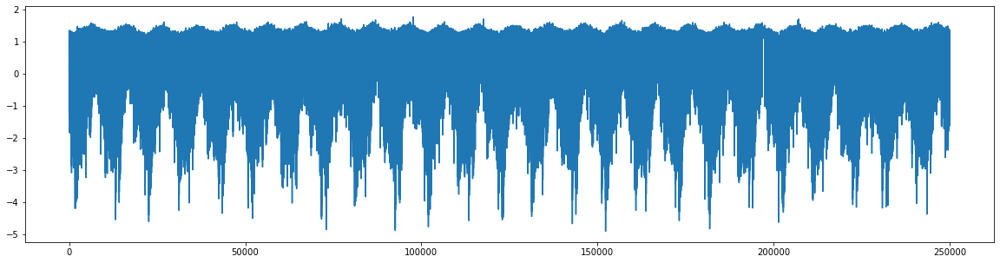

In [12]:
plt.figure(figsize=(20,5))
plt.plot(df1[df1.columns[1]])
plt.show


In [13]:
def fft(data,sr):#data must be an array
    transform= np.fft.fft(data)
    Ymag= transform.real
    N=len(Ymag)
    print(N)
    n=np.arange(N)
    #sr=20000#sampling rate/freq
    T1=N/sr#time period/interval
    freq=n/T1
    n_oneside=N//2
    f_oneside=freq[:n_oneside]
    print(len(f_oneside))
    plt.figure(figsize = (15, 5))
    plt.plot(f_oneside, np.absolute(transform)[:n_oneside])
    #plt.xlim(0,1000)
    plt.xlabel('Freq (Hz)')
    plt.ylabel('FFT Amplitude')
    plt.show()

#call above function if you want to see its FFT. Make sure to change the sampling freq to 50000

# Time Frequency analysis

## Extracting features for column

In [10]:
path1=r"D:\MAFAULDA\horizontal-misalignment\0.5mm"
list1 = os.listdir(path1)
list1

['12.288.csv',
 '13.5168.csv',
 '14.5408.csv',
 '15.36.csv',
 '16.384.csv',
 '17.408.csv',
 '18.8416.csv',
 '19.6608.csv',
 '20.48.csv',
 '21.504.csv',
 '22.528.csv',
 '23.552.csv',
 '24.3712.csv',
 '24.7808.csv',
 '25.8048.csv',
 '26.8288.csv',
 '28.672.csv',
 '29.2864.csv',
 '30.3104.csv',
 '31.5392.csv',
 '32.3584.csv',
 '33.1776.csv',
 '34.2016.csv',
 '35.2256.csv',
 '36.6592.csv',
 '37.888.csv',
 '38.5024.csv',
 '39.1168.csv',
 '40.3456.csv',
 '41.984.csv',
 '42.5984.csv',
 '43.008.csv',
 '44.2368.csv',
 '44.8512.csv',
 '46.8992.csv',
 '47.7184.csv',
 '48.3328.csv',
 '49.5616.csv',
 '50.176.csv',
 '51.4048.csv',
 '52.224.csv',
 '53.248.csv',
 '54.4768.csv',
 '55.0912.csv',
 '56.1152.csv',
 '57.344.csv',
 '58.1632.csv',
 '59.8016.csv',
 '60.6208.csv',
 '62.0544.csv']

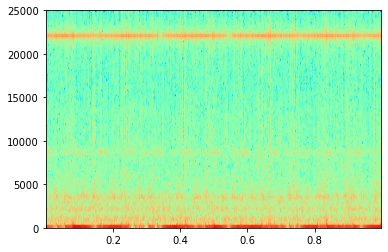

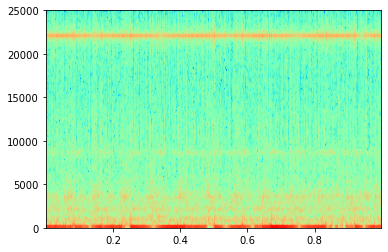

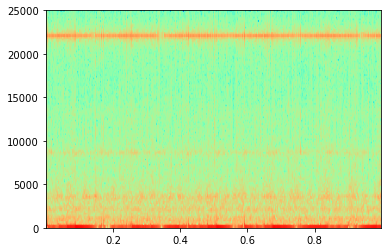

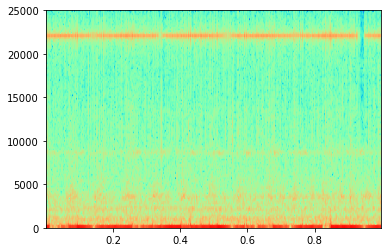

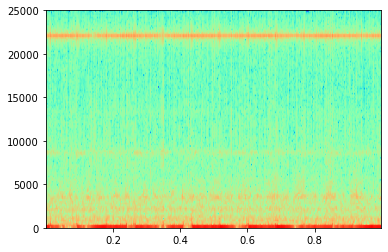

...

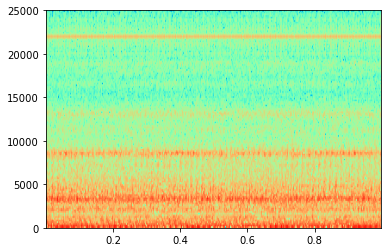

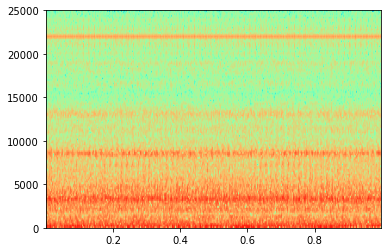

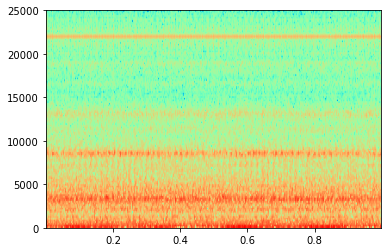

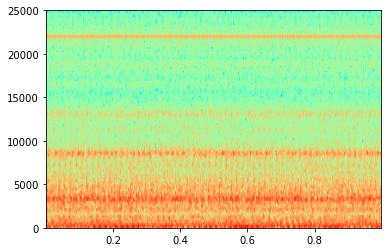

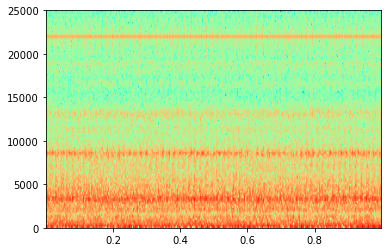

In [62]:
path=r"D:\MAFAULDA\horizontal-misalignment\0.5mm"
list1 = os.listdir(path)
mean_time2=[]
mean_stft2=[]
median_stft2=[]
std1_stft2 =[]
var_stft2 = []
skew_stft2 =[]
kurt_stft2 =[]
max_stft2 = []
min_stft2 = []
median_time2=[]
std1_time2=[]
var_time2= []
skew_time2=[]
kurt_time2=[]
max_time2= []
min_time2= []
rms_time2=[]
rms_stft2=[]
crest_stft2=[]
crest_time2=[]
form_stft2=[]
form_time2=[]
stft_raw2=[]
for files in list1:
    dft=pd.read_csv(f"{path}\{files}", sep=',')
    datat2=dft[dft.columns[6]]#CHANGE THE COLUMN NUMBER TO GET FEATURES FOR ANY OTHER COLUMN YOU WANT
    datat=[]
    for i in range(5):
        datat=datat2[50000*i:50000*(i+1)]
        feat_time2=Features(datat)
        feat_time2.features_normal(datat)
        mean_time2.append(feat_time2.mean)
        median_time2.append(feat_time2.median)
        std1_time2.append(feat_time2.std1) 
        var_time2.append(feat_time2.var) 
        skew_time2.append(feat_time2.skew) 
        kurt_time2.append(feat_time2.kurt)
        max_time2.append(feat_time2.max) 
        min_time2.append(feat_time2.min)  
        rms_time2.append(feat_time2.rms)
        crest_time2.append(feat_time2.crest)
        form_time2.append(feat_time2.form)
    
        spec2=plt.specgram(datat, Fs=50000, cmap="rainbow")
        stft2=spec2[0]
        #below line saves the plot to the directory you enter
        #plt.savefig('3rd_test_plots\EMG {0}.jpg'.format(files))

        #below line saves the STFT to the directory you enter
        #np.savetxt('2nd_test_STFTs\EMG {0}.csv'.format(files),stft2, delimiter=",")
        stft2=stft2.flatten()
        stft_raw2.append(stft2)
        feat_stft2=Features(stft2)
        feat_stft2.features_normal(stft2)
        mean_stft2.append(feat_stft2.mean)
        median_stft2.append(feat_stft2.median)
        std1_stft2.append(feat_stft2.std1)
        var_stft2.append(feat_stft2.var) 
        skew_stft2.append(feat_stft2.skew) 
        kurt_stft2.append(feat_stft2.kurt) 
        max_stft2.append(feat_stft2.max) 
        min_stft2.append(feat_stft2.min)
        rms_stft2.append(feat_stft2.rms)
        crest_stft2.append(feat_stft2.crest)
        form_stft2.append(feat_stft2.form)
        plt.show()
        #plt.savefig("path/{0}/{1}.pdf".format(i,i));
        plt.close()

# Saving all the feature in a feature matrix and then saving

In [63]:
feature_mat1=pd.DataFrame({'mean_time2':mean_time2,'mean_stft2':mean_stft2,'median_time2':median_time2,'median_stft2':median_stft2,'std1_time2':std1_time2,'std1_stft2':std1_stft2,'var_time2':var_time2,'var_stft2':var_stft2,'max_time2':max_time2,'max_stft2':max_stft2,'min_time2':min_time2,'min_stft2':min_stft2,'kurt_time2':kurt_time2,'kurt_stft2':kurt_stft2,'skew_time2':skew_time2,'skew_stft2':skew_stft2,'rms_time2':rms_time2,'rms_stft2':rms_stft2,'crest_time2':crest_time2,'crest_stft2':crest_stft2,'form_time2':form_time2,'form_stft2':form_stft2})
print(feature_mat1)


     mean_time2  mean_stft2  median_time2  median_stft2  std1_time2  \
0     -0.035565    0.000005      0.006182  3.819766e-09    0.365876   
1     -0.054043    0.000008     -0.115285  3.922998e-09    0.438103   
2      0.097469    0.000009      0.120155  3.703172e-09    0.456435   
3      0.010234    0.000008     -0.030516  3.802960e-09    0.452250   
4     -0.005244    0.000007     -0.056846  3.665208e-09    0.430724   
..          ...         ...           ...           ...         ...   
245    0.094489    0.000007      0.095854  9.905177e-08    0.405017   
246   -0.018629    0.000006     -0.022274  9.783142e-08    0.389532   
247   -0.207658    0.000008     -0.206380  9.916042e-08    0.397711   
248    0.026853    0.000006      0.031285  9.647014e-08    0.396725   
249    0.071729    0.000006      0.074533  9.885001e-08    0.394107   

     std1_stft2  var_time2     var_stft2  max_time2  max_stft2  ...  \
0      0.000066   0.133865  4.365849e-09     1.0971   0.002974  ...   
1    

In [64]:
np.savetxt('features_horz_algn_0.5mm_col6.csv',feature_mat1, delimiter=",", header='mean_time2,mean_stft2,median_time2,median_stft2,std1_time2,std1_stft2,var_time2,var_stft2,max_time2,max_stft2,min_time2,min_stft2,kurt_time2,kurt_stft2,skew_time2,skew_stft2,rms_time2,rms_stft2,crest_time2,crest_stft2,form_time2,form_stft2')
#Remeber to change the file name(the one inside the quotes) before saving a feature matrix for a column else it will keep overwriting on the older one
#SO TO GET FEATURE MATRICES OF ALL 6 COLUMNS JUST CHANGE THE COLUMN NUMBER MENTIONED IN THE CODE ABOVE AND THE FILE NAME WITH WHICH YOU WANT TO SAVE IT

### Plotting few features  

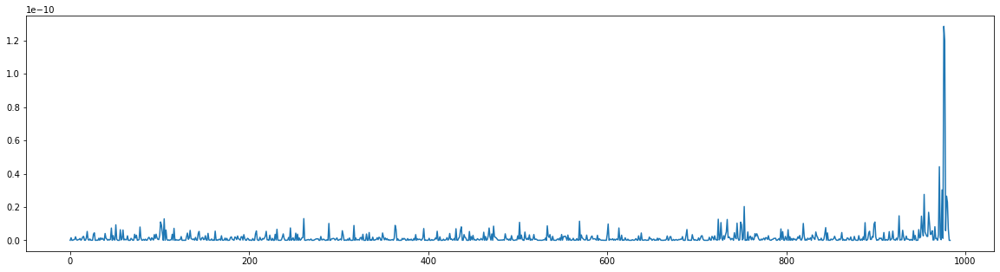

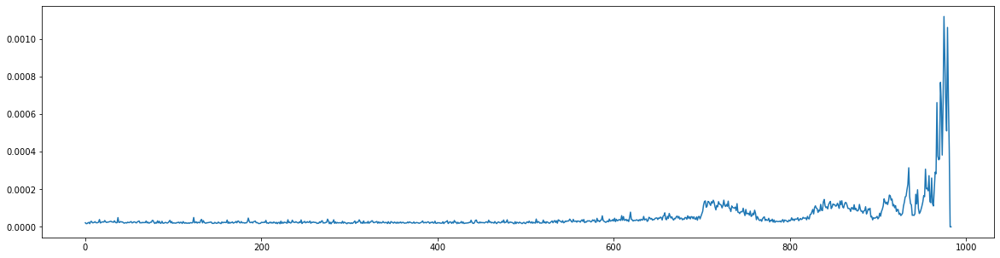

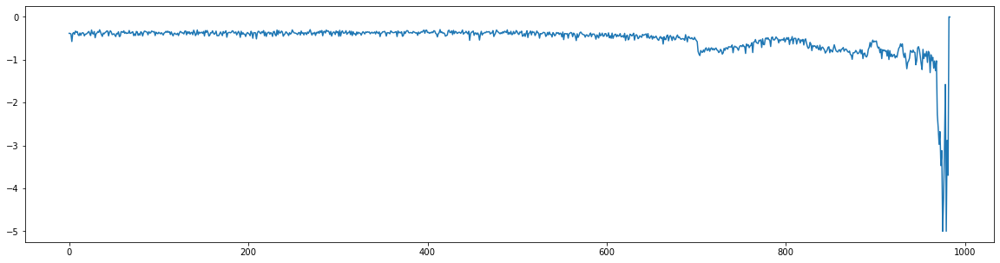

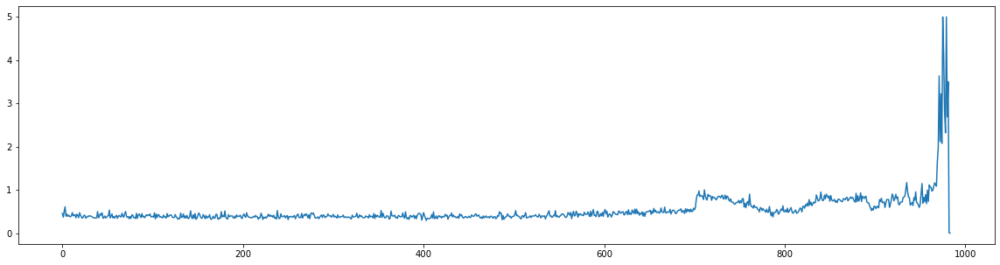

In [31]:
print(type(stft2))
print(len(stft2))
stft2.shape

plt.figure(figsize=(20,5))
plt.plot(mean_time2)

plt.figure(figsize=(20,5))
plt.plot(mean_stft2)

plt.figure(figsize=(20,5))
plt.plot(std1_stft2)

plt.figure(figsize=(20,5))
plt.plot(std1_time2)

plt.figure(figsize=(20,5))
plt.plot(var_time2)

plt.figure(figsize=(20,5))
plt.plot(var_stft2)

np.shape(kurt_stft2)

# kurt_stft2_arr=np.array(kurt_stft2)
# len(kurt_stft2_arr[:,4])

# for i in range(kurt_stft2_arr.shape[1]):
#     plt.figure(figsize=(20,5))
#     plt.plot(kurt_stft2_arr[:,i])
#     plt.show()
#     plt.close()

plt.figure(figsize=(20,5))
plt.plot(kurt_time2)

plt.figure(figsize=(20,5))
plt.plot(median_stft2)

plt.figure(figsize=(20,5))
plt.plot(median_time2)

plt.figure(figsize=(20,5))
plt.plot(var_stft2)

plt.figure(figsize=(20,5))
plt.plot(min_stft2)

plt.figure(figsize=(20,5))
plt.plot(max_stft2)

plt.figure(figsize=(20,5))
plt.plot(min_time2)

plt.figure(figsize=(20,5))
plt.plot(max_time2)

## Feature ranking and selection methods (Not required for this dataset)

In [24]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

Once the feature matrix is saved, we don't need to run the loop again. Just directly read the csv files and access all the features.

In [28]:

feature_out=pd.read_csv('result.csv',header=None)
X=feature_out

In [15]:
Y=[0]*910+[1]*74
len(Y)
X=feature_mat
X

NameError: name 'feature_mat' is not defined

### Feature ranking using selectKBest

In [32]:
# Feature extraction
test = SelectKBest(k=4)
fit = test.fit(X, Y)

# Summarize scores
np.set_printoptions(precision=8)
print(fit.scores_)

features = fit.transform(X)
# Summarize selected features
print(features[0:5,:])

[  4.23801529 427.29665304  58.70960692 202.0419216  767.36586749
 580.05747625 428.20322074 177.65477989 382.09808144 547.72931889
 483.57101725  76.56140615  77.39177034  22.4087483  176.63366681
  26.53029036 767.89389185 551.81295147]
[[7.34780186e-02 1.20875490e-06 7.41800194e-02 1.32819637e-06]
 [7.53394357e-02 1.10776336e-06 7.53817891e-02 1.24218884e-06]
 [7.61888129e-02 1.23470201e-06 7.62276180e-02 1.36426711e-06]
 [7.86944782e-02 1.34676360e-06 7.87255089e-02 1.48163881e-06]
 [7.84400354e-02 1.36603698e-06 7.84748514e-02 1.49642234e-06]]


### Feature ranking using Recursive Feature Elimination

In [31]:
model = LogisticRegression()
rfe = RFE(model, 3)
fit = rfe.fit(X, Y)
print("Num Features: %s" % (fit.n_features_))
print("Selected Features: %s" % (fit.support_))
print("Feature Ranking: %s" % (fit.ranking_))

Num Features: 3
Selected Features: [False False False False False False False False  True False  True False
 False False  True False False False]
Feature Ranking: [ 9 13  7 14  4 12  5 15  1 10  1 16  2  8  1  6  3 11]


C:\Users\AYUSHMAN\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=3 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\AYUSHMAN\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [29]:
X

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,-0.010194,5.504700e-07,-0.010,1.743277e-07,0.073478,1.208755e-06,5.399019e-03,1.461088e-12,0.454,2.163241e-05,-0.386,3.924522e-15,0.628672,46.189979,0.083923,5.805668,0.074180,1.328196e-06
1,-0.002581,5.620440e-07,-0.002,1.978781e-07,0.075339,1.107763e-06,5.676031e-03,1.227140e-12,0.369,1.702339e-05,-0.388,1.557447e-12,0.648479,37.202710,0.052051,5.170229,0.075382,1.242189e-06
2,-0.002490,5.802893e-07,-0.002,1.944015e-07,0.076189,1.234702e-06,5.804735e-03,1.524489e-12,0.503,1.786529e-05,-0.400,2.318237e-15,0.513839,44.457998,0.032867,5.702214,0.076228,1.364267e-06
3,-0.002278,6.176418e-07,-0.002,1.932261e-07,0.078694,1.346764e-06,6.192821e-03,1.813772e-12,0.608,2.194202e-05,-0.576,7.147674e-14,1.157776,46.050751,0.041520,5.779666,0.078726,1.481639e-06
4,-0.002401,6.109196e-07,-0.002,1.894036e-07,0.078440,1.366037e-06,6.152839e-03,1.866057e-12,0.391,2.385110e-05,-0.391,3.798341e-13,0.603207,52.343708,0.028132,6.058851,0.078475,1.496422e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
979,-0.002748,5.234477e-05,0.010,2.198323e-05,0.725031,8.183992e-05,5.256705e-01,6.697773e-09,4.998,1.061954e-03,-5.000,2.657145e-11,12.576977,24.612453,-0.510562,3.968789,0.725019,9.714807e-05
980,-0.004495,2.106534e-05,0.012,7.238703e-06,0.462011,4.335811e-05,2.134540e-01,1.879926e-09,2.688,6.899171e-04,-2.881,2.296783e-11,3.759714,50.656100,-0.325310,6.006280,0.462021,4.820451e-05
981,-0.001703,2.338813e-05,0.020,8.522490e-06,0.483856,3.726951e-05,2.341167e-01,1.389017e-09,3.501,4.066262e-04,-3.696,6.785950e-12,4.891370,13.496643,-0.377087,3.172704,0.483847,4.400024e-05
982,0.001857,4.400082e-10,0.002,4.403320e-11,0.000987,3.220180e-09,9.749108e-07,1.036956e-17,0.005,5.728181e-08,0.000,9.644397e-16,3.637219,112.711730,0.579706,10.145205,0.002103,3.250102e-09


### Correlation Matrices and Scores

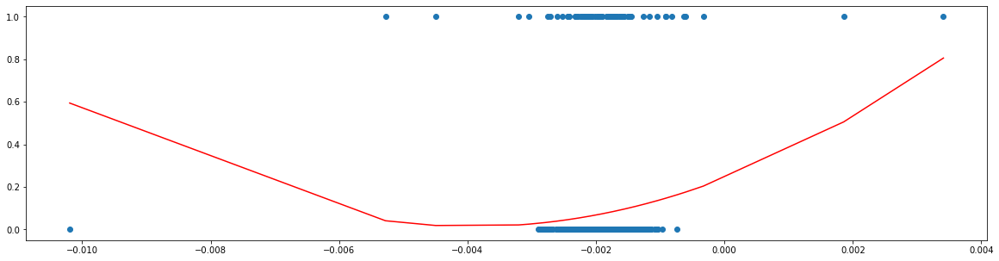

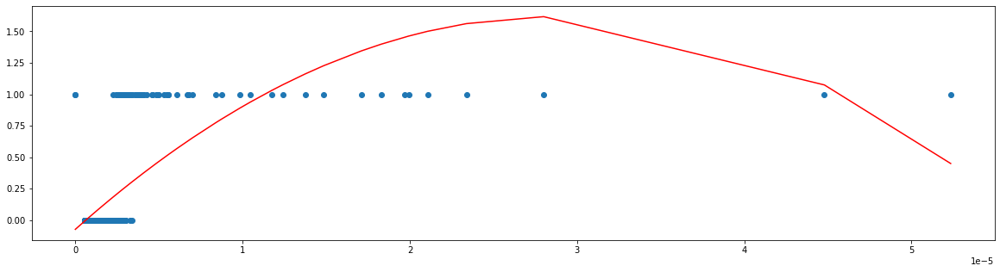

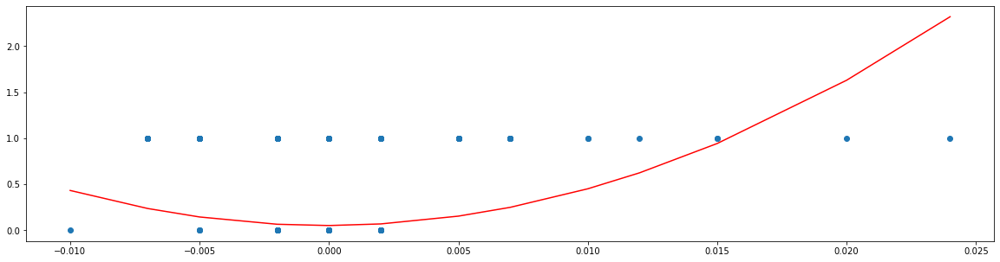

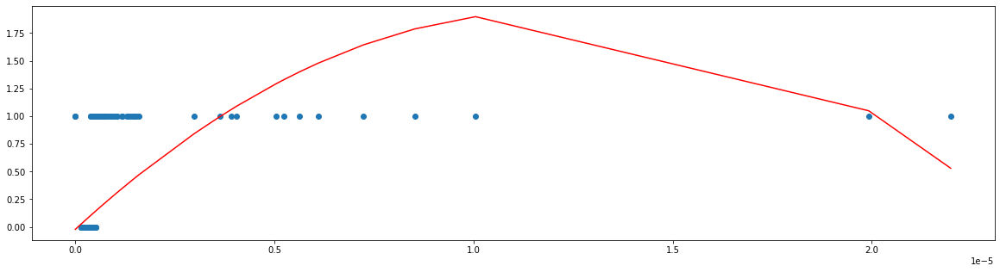

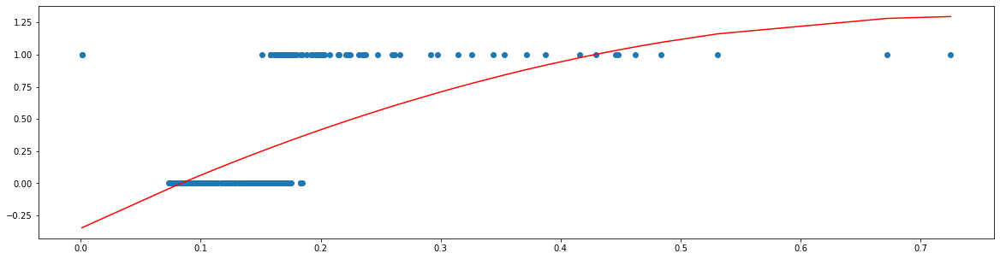

...

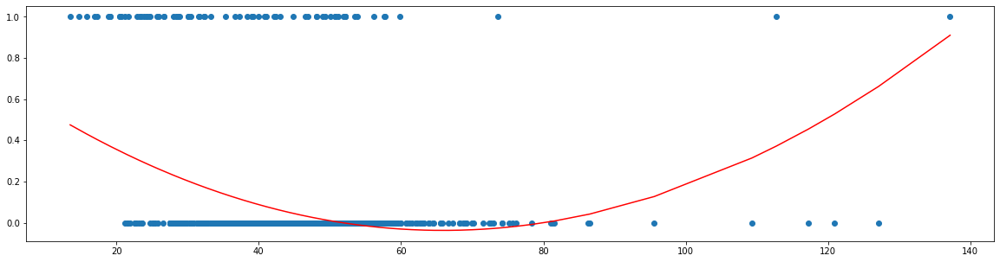

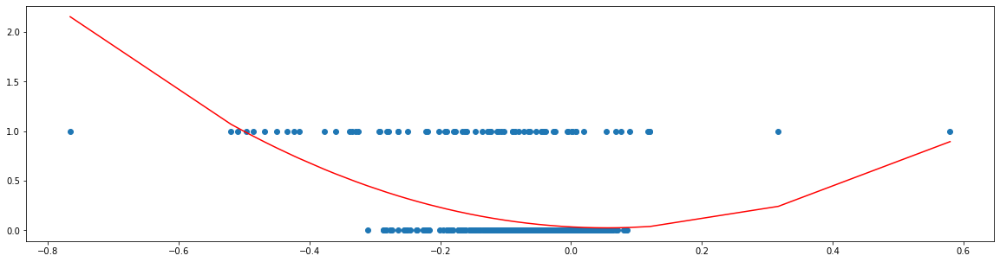

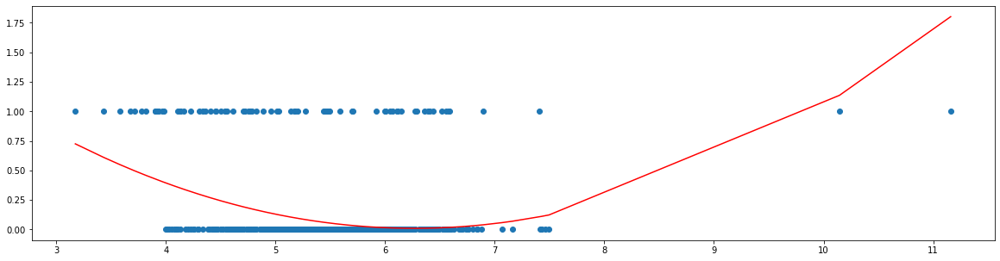

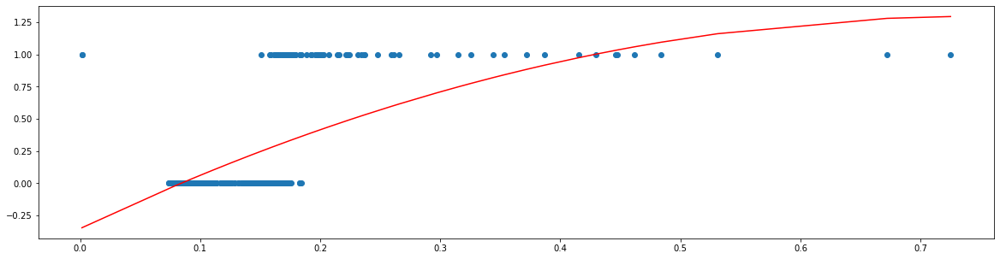

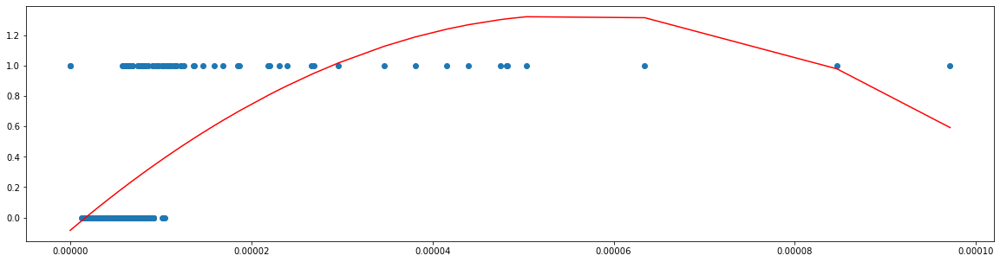

In [188]:
Y_series=pd.Series(Y)
correlation1=[]
for i in range(X.shape[1]):

    feature_series=pd.Series(X[i])
    correlation1.append(Y_series.corr(feature_series))
    

    # plotting the data
    plt.figure(figsize=(20,5))
    plt.scatter(feature_series, Y_series)
    
    # This will fit the best line into the graph
    plt.plot(np.unique(feature_series), np.poly1d(np.polyfit(feature_series, Y_series, 2))
             (np.unique(feature_series)), color='red')
    plt.show()
    plt.close()
   

In [189]:
correlation1

[0.06555267070596144,
 0.5506346478919182,
 0.23751432311192078,
 0.41308288894985074,
 0.6623093934242232,
 0.6093783344404808,
 0.5510412538675806,
 0.39140294336203013,
 0.5292545855095403,
 0.598378111811928,
 -0.5744162241071961,
 0.2689347499969498,
 0.27028322558149637,
 -0.14936662083863933,
 -0.3904484206538758,
 -0.16219091667367075,
 0.6624372550584426,
 0.599804534149387]

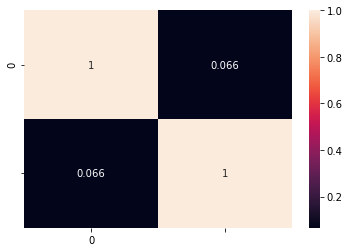

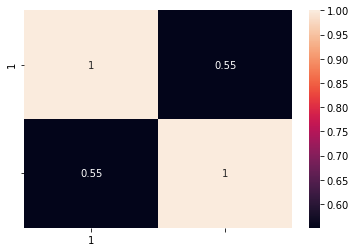

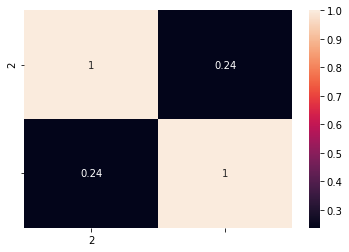

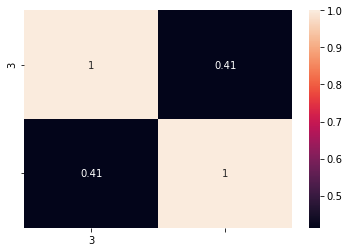

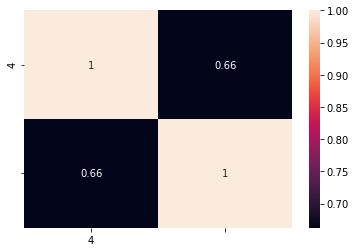

...

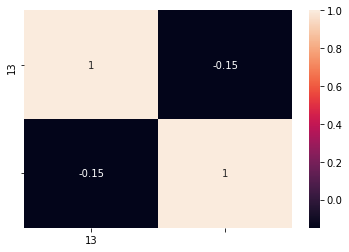

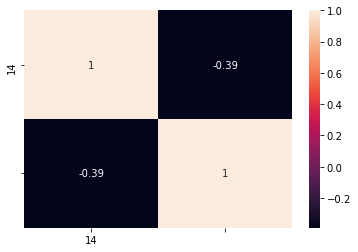

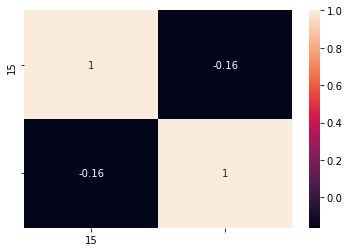

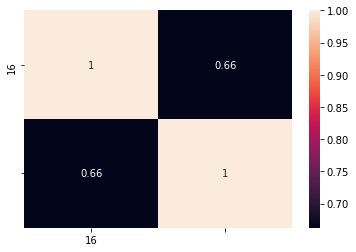

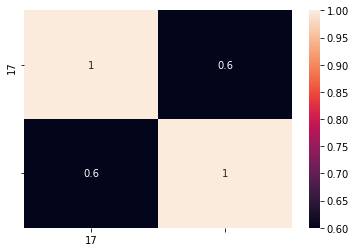

In [16]:
for i in range(X.shape[1]):
    test=pd.DataFrame(X.iloc[:,i])
    test.insert(1,'',Y)
    
    
    #ploting the heatmap for correlation
    sns.heatmap(test.corr(), annot=True)
    plt.show()
    plt.close()


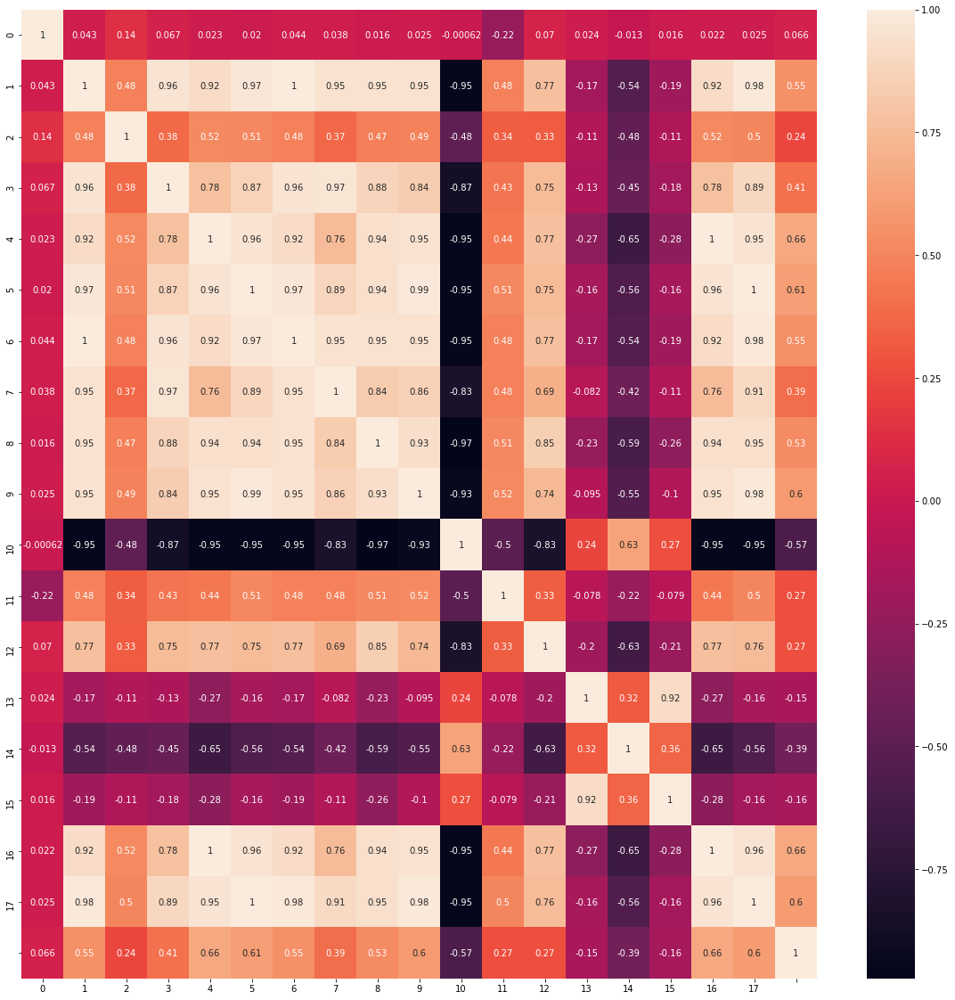

In [21]:
#ploting the heatmap for correlation
test=pd.DataFrame(X)
#test.insert(18,'',Y)
plt.figure(figsize=(20,20))
sns.heatmap(test.corr(), annot=True)
plt.show()
plt.close()